In [1]:
from IPython.display import Image     # Import the Image function from IPython.display to display images in Jupyter environments.
from os import chdir                  # Import chdir from os module to change the current working directory.
from scipy.spatial import Delaunay  # Importar Delaunay
import numpy as np                    # Import numpy library for working with n-dimensional arrays and mathematical operations.
import gudhi as gd                    # Import gudhi library for computational topology and computational geometry.
import matplotlib.pyplot as plt       # Import pyplot from matplotlib for creating visualizations and graphs.
import argparse                       # Import argparse, a standard library for writing user-friendly command-line interfaces.
import seaborn as sns                 # Import seaborn for data visualization; it's based on matplotl.
import requests # Import requests library to make HTTP requests in Python easily.
import pandas as pd
from scipy.spatial.distance import pdist, squareform 
from sklearn.decomposition import PCA
from scipy.spatial import KDTree
import pandas as pd
import os

In [5]:
from funciones import mostrar_contenido_csv
from funciones import calcular_y_guardar_centroides
from funciones import calcular_rips_y_persistencia
from funciones import crear_visualizaciones
from funciones import distancias

In [11]:
mostrar_contenido_csv("/home/jupyter-user5/multicellularity_patterns_classification-/101-200/csv/")

Contenido de 0_0_100000_10000_1000.csv:
         0  1    2    3  4
0       71  B    0    0  0
1       71  B    1    0  0
2       71  B    2    0  0
3       71  B    3    0  0
4       71  B    4    0  0
...    ... ..  ...  ... ..
39995  935  B  195  199  0
39996  935  B  196  199  0
39997  935  B  197  199  0
39998  935  B  198  199  0
39999  935  B  199  199  0

[40000 rows x 5 columns]


Contenido de 0_0_100000_10000_100.csv:
         0  1    2    3  4
0       71  B    0    0  0
1       71  B    1    0  0
2       71  B    2    0  0
3       71  B    3    0  0
4       71  B    4    0  0
...    ... ..  ...  ... ..
39995  958  B  195  199  0
39996  958  B  196  199  0
39997  958  B  197  199  0
39998  958  B  198  199  0
39999  958  B  199  199  0

[40000 rows x 5 columns]


Contenido de 0_10_0_10_10.csv:
         0  1    2    3  4
0      215  B    0    0  0
1      215  B    1    0  0
2      215  B    2    0  0
3      215  B    3    0  0
4      215  B    4    0  0
...    ... ..  ...  ... 

In [16]:
import os
import requests
import csv
#Ruta del directorio que contiene los archivos CSV
ruta_directorio = "/home/jupyter-user5/multicellularity_patterns_classification-/101-200/"

# Obtener una lista de todos los archivos CSV en la ruta especificada
archivos_csv = [archivo for archivo in os.listdir(ruta_directorio) if archivo.endswith('.csv')]

# Iterar sobre cada archivo CSV
for archivo_csv in archivos_csv:
    # Construir la ruta completa del archivo
    ruta_completa = os.path.join(ruta_directorio, archivo_csv)
    
    # Leer el archivo CSV y asignar nombres de columnas
    df = pd.read_csv(ruta_completa, header=None)
    nombres_columnas = ['id', 'Tipo', 'X', 'Y', 'Z']  # Reemplazar con los nombres de columnas apropiados
    df.columns = nombres_columnas
    
    # Mostrar las primeras filas del DataFrame
    print("Contenido de", archivo_csv)
    print(df.head(5))
    
    # Contar el número de IDs distintos
    num_ids_distintos = df['id'].nunique()
    print("Número de IDs distintos:", num_ids_distintos)

Contenido de sim 0_0_1000000_10_0 - step_10000.csv
    id  Tipo  X  Y  Z
0   id  Tipo  X  Y  Z
1  181     1  0  0  0
2  181     1  1  0  0
3  181     1  2  0  0
4  181     1  3  0  0
Número de IDs distintos: 1006
Contenido de sim 0_0_1000000_0_1000000 - step_10000.csv
   id  Tipo   X  Y  Z
0  id  Tipo   X  Y  Z
1  12     1  38  0  0
2  12     1  39  0  0
3  12     1  40  0  0
4  12     1  41  0  0
Número de IDs distintos: 1006
Contenido de sim 0_0_1000000_1000000_10 - step_10000.csv
   id  Tipo  X  Y  Z
0  id  Tipo  X  Y  Z
1  12     2  0  0  0
2  12     2  1  0  0
3  12     2  2  0  0
4  12     2  3  0  0
Número de IDs distintos: 987
Contenido de sim 0_0_100000_1000_0 - step_10000.csv
   id  Tipo  X  Y  Z
0  id  Tipo  X  Y  Z
1  96     1  0  0  0
2  96     1  1  0  0
3  96     1  2  0  0
4  96     1  3  0  0
Número de IDs distintos: 845
Contenido de sim 0_0_1000000_1000000_10000 - step_10000.csv
   id  Tipo  X  Y  Z
0  id  Tipo  X  Y  Z
1  71     2  0  0  0
2  71     2  1  0  0
3  71 

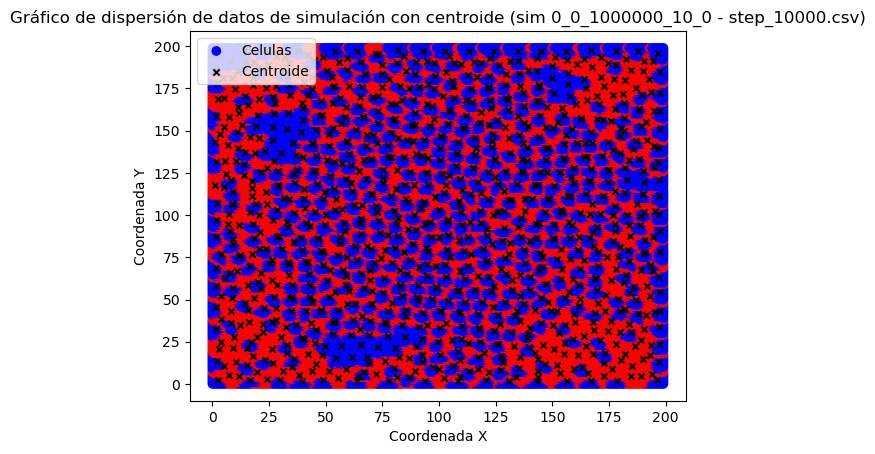

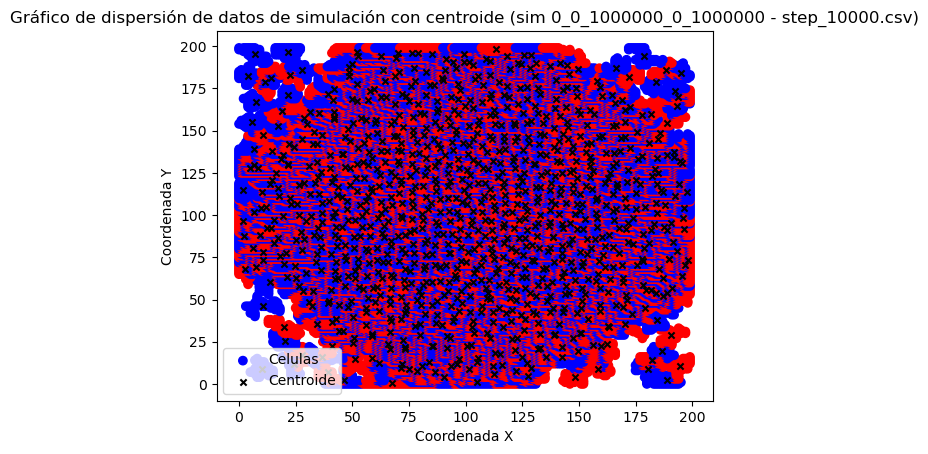

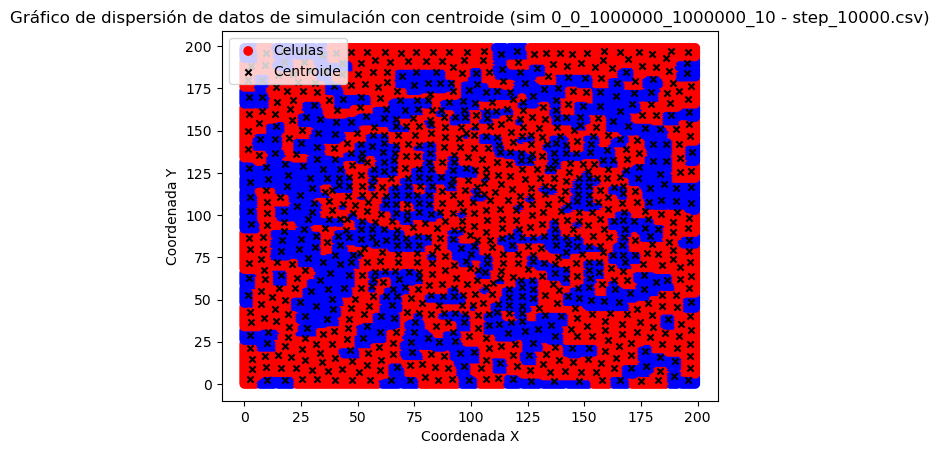

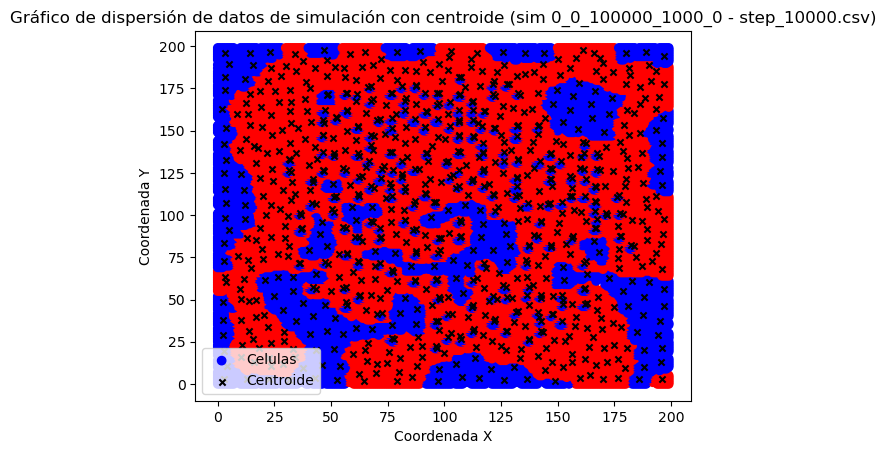

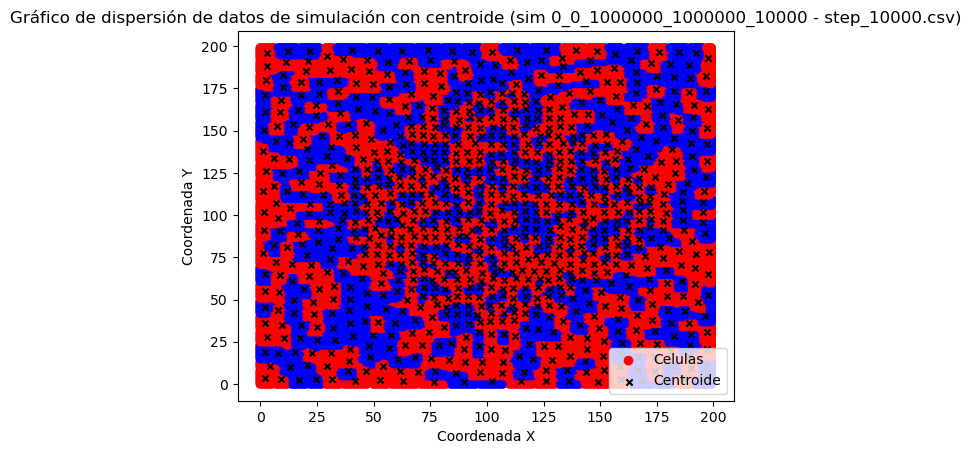

...

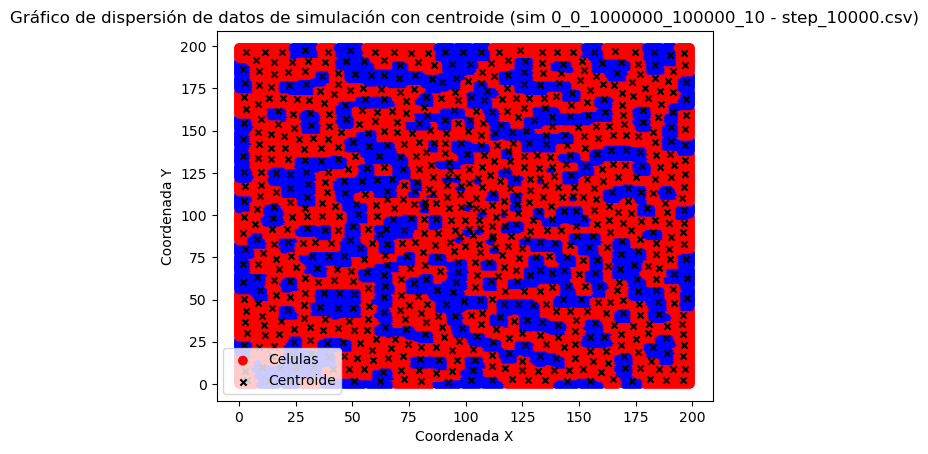

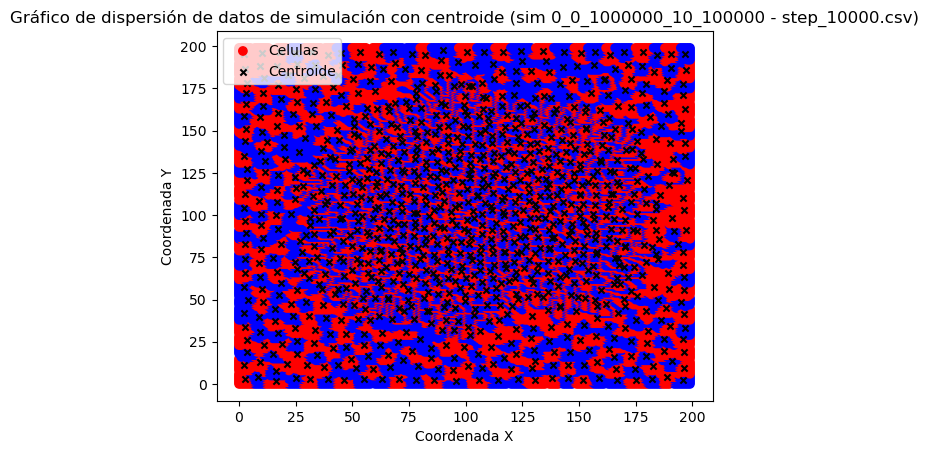

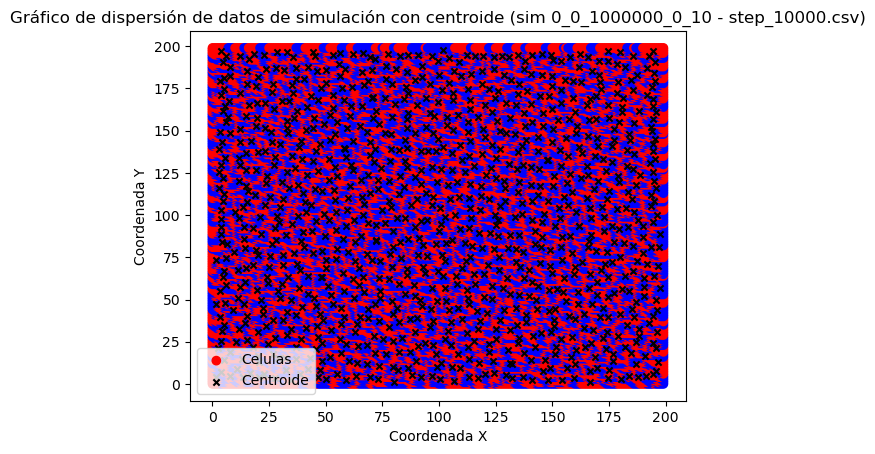

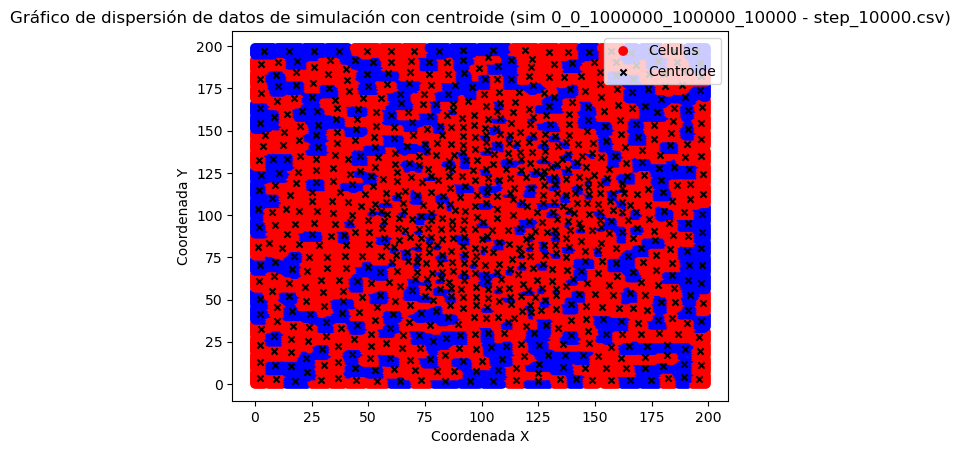

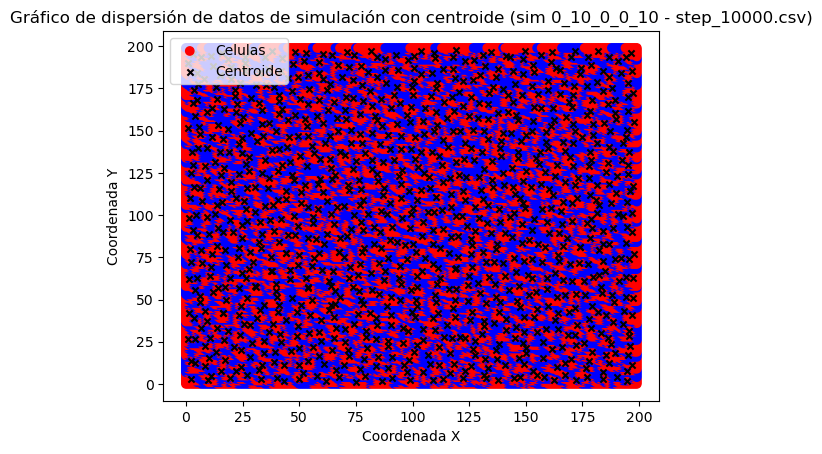

DataFrame 1:
      centroides_x  centroides_y id
0        39.300000      1.750000  A
1        44.100000      7.500000  B
2        48.975000      2.050000  A
3        63.868421      1.631579  A
4        76.051282     13.641026  B
...            ...           ... ..
1000    113.378378    197.054054  A
1001    124.024390    197.121951  A
1002    126.611111    188.777778  A
1003    134.900000    197.450000  A
1004    166.972973    197.540541  A

[1005 rows x 3 columns]

DataFrame 2:
      centroides_x  centroides_y id
0        75.220000      8.620000  B
1        78.705882      7.607843  A
2        67.560000      0.560000  B
3        90.255319      4.106383  A
4       104.941176      1.392157  A
...            ...           ... ..
1000    113.594595    198.216216  B
1001    125.560000    194.720000  B
1002    128.764706    194.882353  A
1003    123.269231    190.346154  B
1004    166.294118    187.098039  A

[1005 rows x 3 columns]

DataFrame 3:
     centroides_x  centroides_y id
0       64

In [21]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Ruta del directorio que contiene los archivos CSV
ruta_directorio = "/home/jupyter-user5/multicellularity_patterns_classification-/101-200/"

# Obtener una lista de todos los archivos CSV en la ruta especificada
archivos_csv = [archivo for archivo in os.listdir(ruta_directorio) if archivo.endswith('.csv')]

# Inicializar una lista para almacenar los DataFrames
dataframes = []

# Iterar sobre cada archivo CSV
for archivo_csv in archivos_csv:
    # Construir la ruta completa del archivo
    ruta_completa = os.path.join(ruta_directorio, archivo_csv)
    
    # Leer el archivo CSV y asignar nombres de columnas
    df = pd.read_csv(ruta_completa, header=None)
    nombres_columnas = ['id', 'Tipo', 'X', 'Y', 'Z']  # Reemplazar con los nombres de columnas apropiados
    df.columns = nombres_columnas
    
    # Extraer las coordenadas X e Y y el tipo
    X = df['X']
    Y = df['Y']
    tipo = df['Tipo']
    
    # Crear un mapa de colores basado en los tipos
    colores = {'A': 'b', 'B': 'r'}  # Ajusta los colores según tus necesidades
    
    # Asignar colores a cada punto según el tipo
    colores_puntos = [colores[t] for t in tipo]
    
    # Agrupar los datos por el ID
    grupos = df.groupby('id')
    
    # Inicializar listas para almacenar los centroides
    centroides_x = []
    centroides_y = []
    tipos_centroides = []
    
    # Calcular el centroide para cada grupo
    for id_grupo, grupo in grupos:
        X_grupo = grupo['X']
        Y_grupo = grupo['Y']
        centroid_x_grupo = X_grupo.mean()
        centroid_y_grupo = Y_grupo.mean()
        centroides_x.append(centroid_x_grupo)
        centroides_y.append(centroid_y_grupo)
        # Suponiendo que el tipo del centroide es el tipo más frecuente en el grupo
        tipo_centroide = grupo['Tipo'].mode()[0]
        tipos_centroides.append(tipo_centroide)
    
    # Crear el gráfico de dispersión combinado
    plt.scatter(X, Y, c=colores_puntos, label='Celulas')
    plt.scatter(centroides_x, centroides_y, color='black', marker='x', s=20, label='Centroide')  # Agregar el centroide al gráfico
    
    plt.xlabel('Coordenada X')
    plt.ylabel('Coordenada Y')
    plt.title(f'Gráfico de dispersión de datos de simulación con centroide ({archivo_csv})')
    plt.legend() 
    plt.show()
    
    # Crear un DataFrame para cada lista de centroides
    df_centroides = pd.DataFrame({"centroides_x": centroides_x, "centroides_y": centroides_y, "id": tipos_centroides})
    dataframes.append(df_centroides)

# Imprimir los DataFrames
for i, df in enumerate(dataframes):
    print(f"DataFrame {i+1}:")
    print(df)
    print()


In [22]:
calcular_y_guardar_centroides("/home/jupyter-user5/multicellularity_patterns_classification-/1-100/")

Centroides y gráfico guardados para sim 0_10_10_1000000_10000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides.
Centroides y gráfico guardados para sim 0_10_10_10_1000000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides.
Centroides y gráfico guardados para sim 0_10_0_1000_100 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides.
Centroides y gráfico guardados para sim 0_10_10_1000000_1000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides.
Centroides y gráfico guardados para sim 0_10_10_100000_0 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides.
Centroides y gráfico guardados para sim 0_10_10_10_10000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides.
Centroides y gráfico guardados para sim 0_10_0_1

'/home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides'

In [23]:
calcular_y_guardar_centroides("/home/jupyter-user5/multicellularity_patterns_classification-/101-200/")

Centroides y gráfico guardados para sim 0_0_1000000_10_0 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/101-200/centroides.
Centroides y gráfico guardados para sim 0_0_1000000_0_1000000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/101-200/centroides.
Centroides y gráfico guardados para sim 0_0_1000000_1000000_10 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/101-200/centroides.
Centroides y gráfico guardados para sim 0_0_100000_1000_0 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/101-200/centroides.
Centroides y gráfico guardados para sim 0_0_1000000_1000000_10000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/101-200/centroides.
Centroides y gráfico guardados para sim 0_0_1000000_100000_0 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/101-200/centroides.
Centroides y gráfico 

'/home/jupyter-user5/multicellularity_patterns_classification-/101-200/centroides'

In [24]:
calcular_y_guardar_centroides("/home/jupyter-user5/multicellularity_patterns_classification-/201-300/")

Centroides y gráfico guardados para sim 0_0_1000_100000_100000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/201-300/centroides.
Centroides y gráfico guardados para sim 0_0_1000_1000_0 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/201-300/centroides.
Centroides y gráfico guardados para sim 0_0_1000_100000_100 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/201-300/centroides.
Centroides y gráfico guardados para sim 0_0_1000_100_10000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/201-300/centroides.
Centroides y gráfico guardados para sim 0_0_1000_1000000_10000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/201-300/centroides.
Centroides y gráfico guardados para sim 0_0_10000_10000_1000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/201-300/centroides.
Centroides y gráfico guard

'/home/jupyter-user5/multicellularity_patterns_classification-/201-300/centroides'

In [25]:
calcular_y_guardar_centroides("/home/jupyter-user5/multicellularity_patterns_classification-/301-400")

Centroides y gráfico guardados para sim 0_0_10_1000000_1000000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/301-400/centroides.
Centroides y gráfico guardados para sim 0_0_10_1000_1000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/301-400/centroides.
Centroides y gráfico guardados para sim 0_0_100_1000000_1000000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/301-400/centroides.
Centroides y gráfico guardados para sim 0_0_10_100_100000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/301-400/centroides.
Centroides y gráfico guardados para sim 0_0_1000_10_100 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/301-400/centroides.
Centroides y gráfico guardados para sim 0_0_100_100_0 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/301-400/centroides.
Centroides y gráfico guardados para 

'/home/jupyter-user5/multicellularity_patterns_classification-/301-400/centroides'

In [26]:
calcular_y_guardar_centroides("/home/jupyter-user5/multicellularity_patterns_classification-/400-462/")

Centroides y gráfico guardados para sim 0_0_0_10000_100000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/400-462/centroides.
Centroides y gráfico guardados para sim 0_0_0_0_0 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/400-462/centroides.
Centroides y gráfico guardados para sim 0_0_0_10000_1000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/400-462/centroides.
Centroides y gráfico guardados para sim 0_0_0_10_1000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/400-462/centroides.
Centroides y gráfico guardados para sim 0_0_0_0_10 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/400-462/centroides.
Centroides y gráfico guardados para sim 0_0_10_10_100000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/400-462/centroides.
Centroides y gráfico guardados para sim 0_0_10_0_10000 - ste

'/home/jupyter-user5/multicellularity_patterns_classification-/400-462/centroides'

usetex mode requires TeX.


Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_10_1000000_10000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_10_10_1000000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_0_1000_100 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_10_1000000_1000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_10_100000_0 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de 

/opt/conda/envs/TDA/lib/python3.7/site-packages/gudhi/persistence_graphical_tools.py:306: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, axes = plt.subplots(1, 1)
/home/jupyter-user5/multicellularity_patterns_classification-/codigos/funciones.py:147: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(12, 5))


Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_10_1000000_1000000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_0_10000_10 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_100_0_10000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_0_100000_100000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama de persistencia guardados para sim 0_10_10_10000_100000 - step_10000.csv en /home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/persistencia.
Gráfico de Rips y diagrama

/opt/conda/envs/TDA/lib/python3.7/site-packages/IPython/core/events.py:89: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
/opt/conda/envs/TDA/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


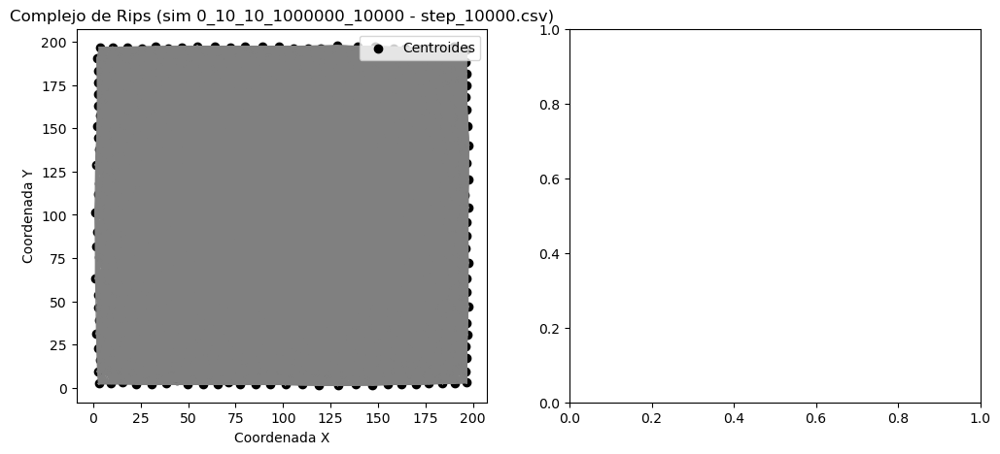

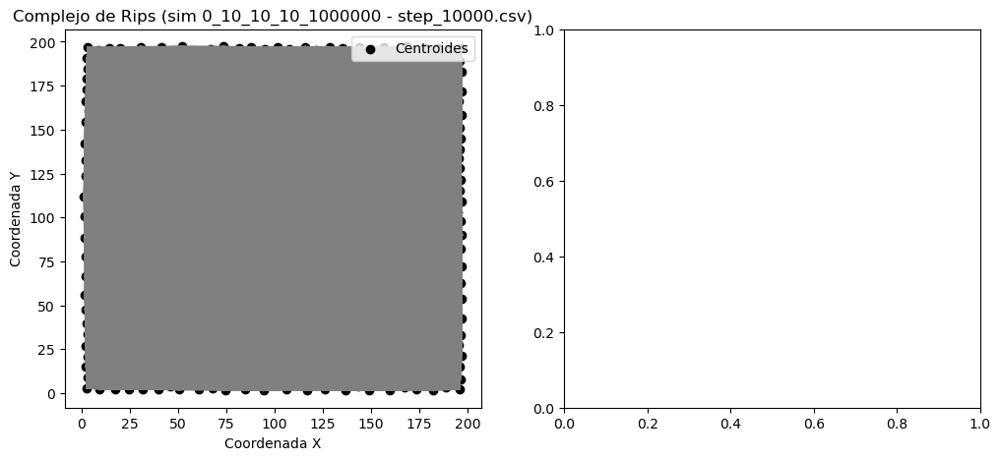

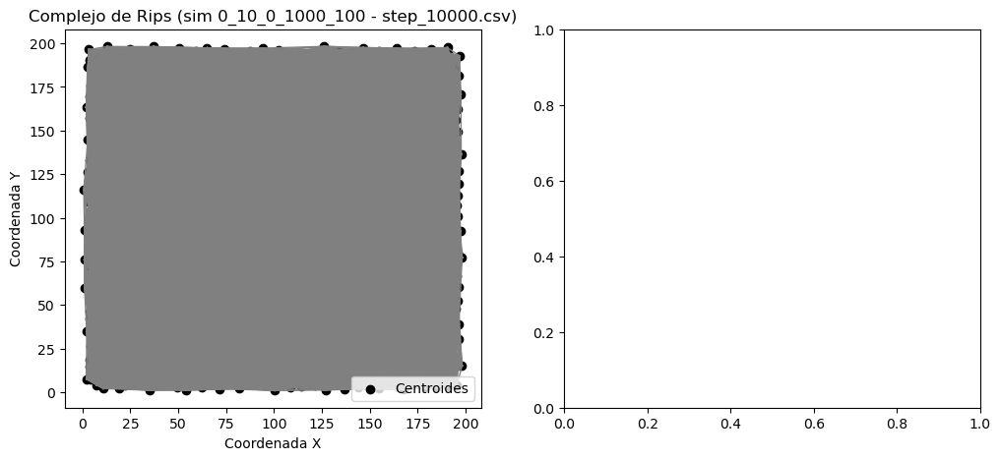

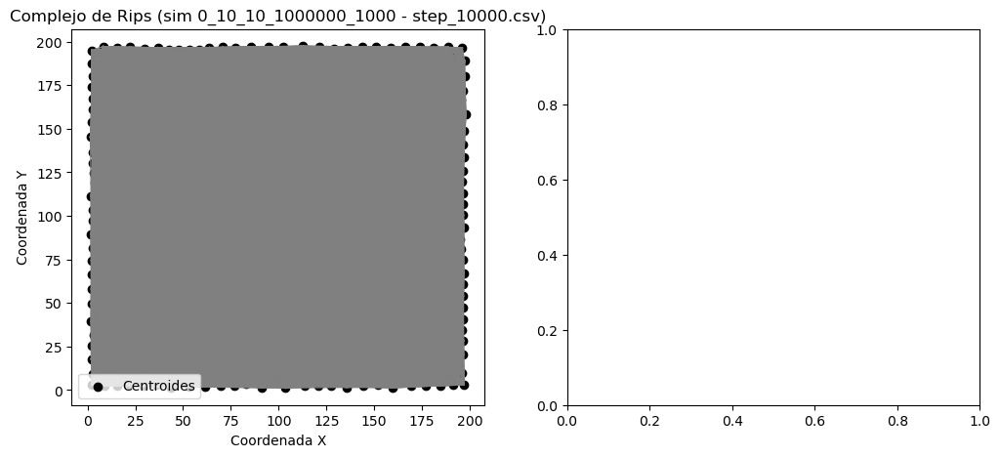

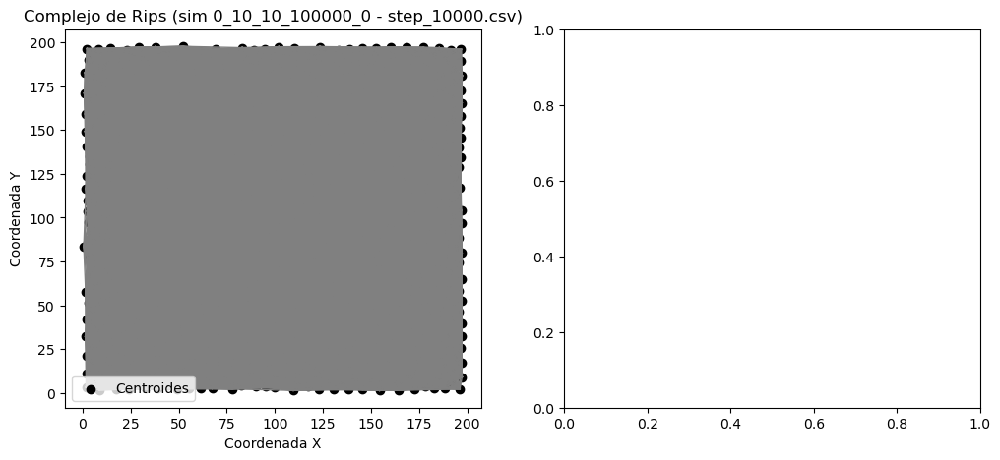

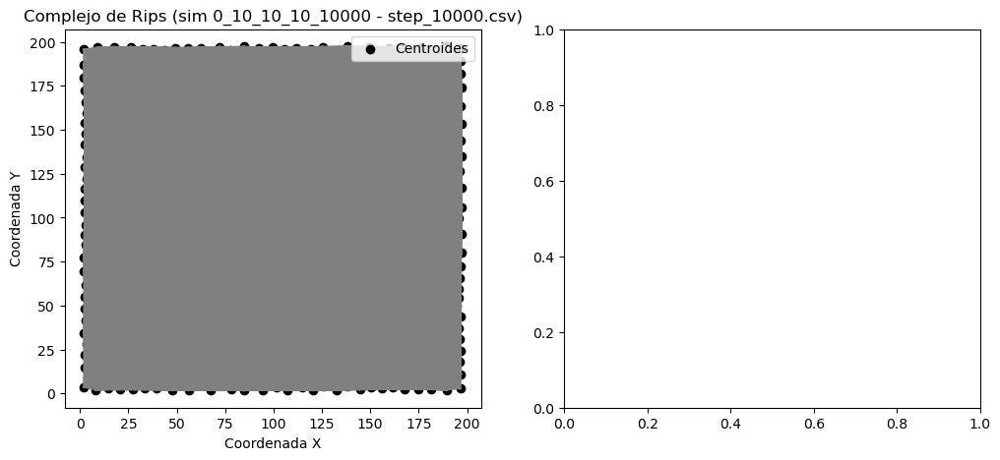

In [ ]:
import time
start_time = time.time()
calcular_rips_y_persistencia("/home/jupyter-user5/multicellularity_patterns_classification-/1-100/centroides/")
end_time = time.time()
elapsed_time = end_time - start_time
print(f"El tiempo de ejecución fue: {elapsed_time:.2f} segundos.")
